In [ ]:
import snntorch as snn
import torch
from torch import nn

import matplotlib.pyplot as plt
import matplotlib
import numpy as np
from IPython import display
from IPython.display import clear_output, HTML, Video

import snntorch as snn
from snntorch import spikeplot as splt
from snntorch import spikegen
from snntorch import surrogate
from snntorch import functional as SF
from snntorch import utils
import torch.nn as nn

from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms
from torch.nn.functional import pad, softmax

from tqdm import tqdm
from math import sqrt

import tonic
import random
from tonic import DiskCachedDataset
import tonic.transforms as transforms

import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
seed = 0

if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)
else:
    torch.manual_seed(seed)
    device = "cpu"
print(f"Running on {device}")

#RUN ONCE
#!echo '/data' >> .gitignore

### Load DVSGesture data, Utilities functions

In [ ]:
class SpikeAnimation():
    def __init__(self, num_plots, color_map = 'coolwarm', frames = None):
        self.to_plot = []
        self.sizes = []
        self.ims = []
        self.color_map = color_map
        self.calc_frames = True
        self.fig, self.axs = plt.subplots(1, num_plots)
        if frames is not None:
            self.frames = frames
            self.calc_frames = False
        return
            
                       
    def add_to_plot(self, three_dim_tensor, size, title):
        assert len(three_dim_tensor.shape) == 3, "Not a three dimensional tensor"
        self.to_plot.append(three_dim_tensor.squeeze(1).detach().numpy())
        self.axs[len(self.to_plot)-1].set_title(title)
        self.sizes.append(size)
        self.ims.append( self.axs[len(self.to_plot)-1].imshow(self.to_plot[-1][0].reshape(size), 
                                      cmap = self.color_map) )
        return
        
    def blit(self, n):
        for iii, image in enumerate(self.ims):
            image.set_array(self.to_plot[iii][n].reshape(self.sizes[iii]))
        return self.ims
    
    def show(self, return_obj=False):
        assert len(self.to_plot) != 0, "No spikes loaded"
        ani = matplotlib.animation.FuncAnimation(self.fig, self.blit, frames = self.frames)
        if return_obj:
            return ani
        return HTML(ani.to_jshtml())

def quick_animate(three_dim_tensor, frames, titles=None, return_obj=False,):
    temp = SpikeAnimation(max(2, len(three_dim_tensor)), frames=frames)
    titles = [" "]*len(three_dim_tensor) if titles is None else titles
    for count, iii in enumerate(three_dim_tensor):
        temp.add_to_plot(iii.cpu(), (iii.shape[-1], iii.shape[-2]), f"{titles[count]}")
    return temp.show(return_obj)

def add_to_class(Class):
    """Register functions as methods in created class."""
    def wrapper(obj):
        setattr(Class, obj.__name__, obj)
    return wrapper

def pos_neg_to_frame(loader_tensor):
    # combine positive and negative channels of neuromorphic dataset
    return (loader_tensor[:,:,1]-loader_tensor[:,:,0]).movedim(0,1).unsqueeze(2)

In [ ]:
dataset = tonic.datasets.DVSGesture(save_to='./data',
                               train=True)
sensor_size = tonic.datasets.DVSGesture.sensor_size

frame_transform = transforms.Compose([transforms.CropTime(max=2_000_000),
                                      transforms.Downsample(spatial_factor=0.5),
                                      transforms.ToFrame(sensor_size=(64,64,2),
                                                         time_window=10_000)
                                     ])
trainset = tonic.datasets.DVSGesture(save_to='./data', transform=frame_transform, train=True)
testset = tonic.datasets.DVSGesture(save_to='./data', transform=frame_transform, train=False)

random.seed(seed)
batch_size = 8

subsample_percent = 30

################# DELETE IF USING WHOLE SET
train_subsample_idx = random.sample(range(0, len(trainset)), int(len(trainset)*subsample_percent//100))
test_subsample_idx = random.sample(range(0, len(testset)), int(len(testset)*subsample_percent//100))
trainset = Subset(trainset,  train_subsample_idx)
testset= Subset(testset,  test_subsample_idx)
##########################################

cached_trainset = DiskCachedDataset(trainset, cache_path='./cache/DVSGesture/train')
cached_testset = DiskCachedDataset(testset, cache_path='./cache/DVSGesture/test')

cached_dataloader = DataLoader(cached_trainset, batch_size=batch_size)

train_loader = DataLoader(cached_trainset, batch_size=batch_size, collate_fn=tonic.collation.PadTensors(batch_first=True), shuffle=True)
test_loader = DataLoader(cached_testset, batch_size=batch_size, collate_fn=tonic.collation.PadTensors(batch_first=True))

In [ ]:
class snn_hmax(nn.Module):
    def __init__(self):
        
        super().__init__()
        self.counter = 0
        self.num_ker1 = 4
        self.num_ker2 = 4
        self.num_classes = 11
        self.num_capsule_channels = 4
        self.stdp_inshallah = nn.Conv2d(in_channels=5, out_channels=self.num_capsule_channels, kernel_size=31, stride=1, padding=1, groups=1, bias=True)
        self.s1 = nn.Conv2d(in_channels=1, out_channels=self.num_ker1, 
                                     kernel_size=3, stride=1, padding=0, groups=1, bias=True)
        self.c1 = nn.MaxPool2d(kernel_size=2, stride=None, padding=0)
        self.s2 = nn.Conv2d(in_channels=self.num_ker1, out_channels = self.num_ker2,
                                      kernel_size=4, stride=1, padding=0, bias=True)
        self.c2 = nn.MaxPool2d(kernel_size=2, stride=None, padding=0)
        self.fully_connected1 = nn.Linear(5400, 512)
        self.relu = nn.ReLU()
        self.fully_connected2 = nn.Linear(512, self.num_classes)
        

In [ ]:
model = snn_hmax().to(device)

### Static model methods for step-by-step demonstration

In [39]:
def get_next_batch(loader):
    t = next(iter(loader))
    return pos_neg_to_frame(t[0]), t[1]

@add_to_class(snn_hmax)
@staticmethod
def s1_forward(batch_step, verbose=True):
    assert len(batch_step.shape)==5, "Required shape:[NUM_STEPS, BATCH_SIZE, 1, IM_SIZE, IM_SIZE]"
    all_steps = []
    batch_step = batch_step.to(device)
    for frame in batch_step:
        all_steps.append(model.s1(frame))
    all_steps = torch.stack(all_steps).cpu()

    if verbose:
        print(f"S1 pass:", end=" ")
        print(f"{list(batch_step.shape)}->{list(all_steps.shape)}")
        
    del batch_step
    torch.cuda.empty_cache()
    return all_steps

@add_to_class(snn_hmax)
@staticmethod
def c1_forward(s1_batch_step, verbose=True):
    assert len(s1_batch_step.shape)==5, "Required shape:[NUM_STEPS, BATCH_SIZE, S1_NUM_KER, IM_SIZE, IM_SIZE]"
    all_steps = []
    s1_batch_step = s1_batch_step.to(device)
    for frame in s1_batch_step:
        all_steps.append(model.c1(frame))
    all_steps = torch.stack(all_steps).cpu()
    
    if verbose:
        print(f"C1 pass:", end=" ")
        print(f"{list(s1_batch_step.shape)}->{list(all_steps.shape)}")
        
    del s1_batch_step
    torch.cuda.empty_cache()
    return all_steps

@add_to_class(snn_hmax)
@staticmethod
def s2_forward(c1_batch_step, verbose=True):
    assert len(c1_batch_step.shape)==5, "Required shape:[NUM_STEPS, BATCH_SIZE, C1_NUM_KER, IM_SIZE, IM_SIZE]"
    num_steps, bat_size, num_channels, im_size= c1_batch_step.shape[0:4]
    c1_batch_step = c1_batch_step.to(device)
    all_steps = torch.zeros(num_steps, bat_size, num_channels,3,3) #TURN TO 6,6
    for channel in range(model.num_capsule_channels):
        capsule = torch.zeros((batch_size,5,im_size,im_size))
        for iii, frame in enumerate(c1_batch_step):
            capsule = capsule.roll(-1,1)
            capsule[:len(frame),-1] = frame[:,channel]
            xx = model.c2(model.stdp_inshallah(torch.softmax(capsule.to(device), dim=-1)).reshape(len(frame),6,6))
            ####DELETE THIS
            for image in range(len(frame)):
                if xx[image].mean((0,1)) > 0.01:
                    all_steps[iii,image,channel] = xx[image]

    if verbose:
        print(f"S2 pass:", end=" ")
        print(f"{list(c1_batch_step.shape)}->{list(all_steps.shape)}", end=" ")
        print(f"Capsule: {list(capsule.shape)}")
    del c1_batch_step
    torch.cuda.empty_cache()
    return all_steps.movedim(0,1)

@add_to_class(snn_hmax)
@staticmethod
def c2_forward(s2_batch_step, verbose=True):
    assert len(s2_batch_step.shape)==5, "Required shape:[NUM_STEPS, BATCH_SIZE, S2_NUM_KER, IM_SIZE, IM_SIZE]"
    all_steps = []
    s2_batch_step = s2_batch_step.to(device)
    for frame in s2_batch_step:
        all_steps.append(model.c2(frame))
    all_steps = torch.stack(all_steps).cpu()
    
    if verbose:
        print(f"C2 pass:", end=" ")
        print(f"{list(s2_batch_step.shape)}->{list(all_steps.shape)}")
        
    del s2_batch_step
    torch.cuda.empty_cache()
    return all_steps

@add_to_class(snn_hmax)
@staticmethod
def fc_forward(c2_pooled, verbose=True):
    assert len(c2_pooled.shape)==5, "Required shape:[NUM_STEPS, BATCH_SIZE, C2_NUM_KER, IM_SIZE, IM_SIZE]"
    out = c2_pooled.reshape(c2_pooled.size(0), -1).to(device)
    out = model.fully_connected1(out)
    out = model.relu(out)
    out = model.fully_connected2(out)
    if verbose:
        print(f"FC pass:", end=" ")
        print(f"{list(c2_pooled.shape)}->{list(out.shape)}")
        
    del c2_pooled
    torch.cuda.empty_cache()
    return out

In [40]:
x = get_next_batch(train_loader)[0][0:150]
y = snn_hmax.s1_forward(x)
z = snn_hmax.c1_forward(y)
a = snn_hmax.s2_forward(z)
b = a#snn_hmax.c2_forward(a)
c = snn_hmax.fc_forward(b)

S1 pass: [150, 8, 1, 64, 64]->[150, 8, 4, 62, 62]
C1 pass: [150, 8, 4, 62, 62]->[150, 8, 4, 31, 31]
S2 pass: [150, 8, 4, 31, 31]->[150, 8, 4, 3, 3] Capsule: [8, 5, 31, 31]
FC pass: [8, 150, 4, 3, 3]->[8, 11]


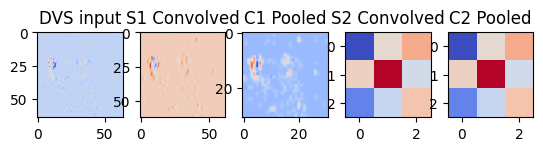

In [41]:
im = 7; chann = 1
quick_animate([x[:,im,0], y[:,im, chann], z[:,im,chann], a.movedim(0,1)[:,im,chann], b.movedim(0,1)[:,im,chann]], 50, 
              ["DVS input", "S1 Convolved", "C1 Pooled", "S2 Convolved", "C2 Pooled"])


In [45]:
@add_to_class(snn_hmax)        
def forward(self, input_spikes, save_plots=False, epoch=0, verbose=False):
    
    num_steps, bat_size= input_spikes.shape[0:2]
    im_size=31
    
    container = torch.zeros(num_steps, bat_size, self.num_capsule_channels, 3,3)
    for channel in range(self.num_capsule_channels):
        capsule = torch.zeros((bat_size,5,im_size,im_size))
        for jjj, batch_step in enumerate(input_spikes):

            s1_reduced = self.s1(batch_step.to(device)) 
            c1_reduced = self.c1(s1_reduced)

            capsule = capsule.roll(-1,1)
            capsule[:len(c1_reduced),-1] = c1_reduced[:,channel]
            xx = self.c2(self.stdp_inshallah(torch.softmax(capsule.to(device), dim=-1)).reshape(len(c1_reduced),6,6))
            
            for image in range(len(c1_reduced)):
                if xx[image].mean((0,1)) > 0:
                    container[jjj,image,channel] = xx[image]
    
    container = container.movedim(0,1)
    out = container.reshape(container.size(0), -1).to(device)
    out = model.fully_connected1(out)
    out = model.relu(out)
    out = model.fully_connected2(out)

    return out

@add_to_class(snn_hmax)
def __call__(self, spikes_in, save_plots=False, epoch=0, verbose=False):
    return self.forward(spikes_in, save_plots, epoch, verbose)

## Initial training

In [46]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999))

Train on 0,4-11 with regular convolutional layers, learn difference between 2 and 3 with just stdp capsule channel?

In [47]:
from tqdm.auto import tqdm

num_epochs = 5
loss_hist = []
counter = 0
weights = []
#weights = list(weights)
# Outer training loop
num_evaluate = 25
switch_flag = False
for epoch in range(num_epochs):
    #Load in the data in batches using the train_loader object
    for i, (images, labels) in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}", position=0, leave=True)):  
        labels = labels.to(device)
        ims = pos_neg_to_frame(images).to(device)[0:150]
        
        if switch_flag:
            weights.append(model.stdp_inshallah.weight.detach().cpu())
            ims = ims[:, (labels == 1) | (labels==2)]
            labels = labels[(labels == 1) | (labels==2)]
            if ims.shape[1] == 0:
                continue
        weights.append(model.stdp_inshallah.weight.detach().cpu())
        
        outputs = model(ims)
        loss = criterion(outputs, labels)
        loss_hist.append(loss)
        
        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
            
        if i%50 == 0:
            with torch.no_grad():
                correct = 0
                total = 0
                #print(f"Alpha: {model.alph}, DD {model.past_alph/model.alph}"); model.past_alph = model.alph
                #print(f"Beta: {model.bet}, DD {model.past_beta/model.bet}"); model.past_beta = model.bet
                for j, (test_images, test_labels) in enumerate(tqdm(train_loader, desc="Testing")):
                    if j == num_evaluate:
                        break
                    ims = pos_neg_to_frame(test_images).to(device)[0:150]
                    
                    if switch_flag:
                        ims = ims[:, (test_labels == 1) | (test_labels==2)]
                        test_labels = test_labels[(test_labels == 1) | (test_labels==2)]
                        if ims.shape[1] == 0:
                            continue
                    
                    test_labels = test_labels.to(device)
                    outputs = model(ims)
                    _, predicted = torch.max(outputs.data, 1)
                    total += test_labels.size(0)
                    correct += (predicted == test_labels).sum().item()
                    if j%50==0:
                        #_ = model(ims, save_plots=True, epoch=epoch)
                        print(f"Predicted: {predicted}")
                        print(f"Labels: {test_labels}")
                    
                print(f'Accuracy of the network: {100*correct/total} %')
                
                if ((100*correct/total) > 30) and not switch_flag:
                    print(f"Switching to alternate subset (1s and 2s)")
                    print("%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%")
                    switch_flag = True
                    optimizer = torch.optim.Adam(model.parameters(), lr=0.003, betas=(0.9, 0.999))
                    
        #s1_weights.append(model.s1.weight.detach().cpu().clone())
        #s2_weights.append(model.s2.weight.detach().cpu().clone())
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")
    
weights = torch.stack(weights)

Epoch 1:   0%|          | 0/41 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 2.00 MiB (GPU 0; 1.96 GiB total capacity; 962.54 MiB already allocated; 1.31 MiB free; 1024.00 MiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
plt.plot([item.cpu().detach() for item in loss_hist])

In [55]:
weights.shape

torch.Size([296, 4, 5, 31, 31])

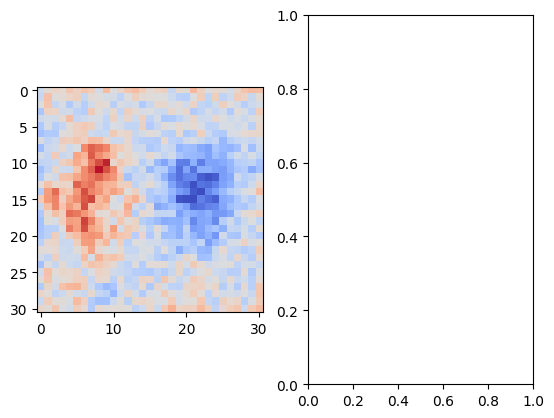

In [54]:
quick_animate([weights[293, 0]], 3)

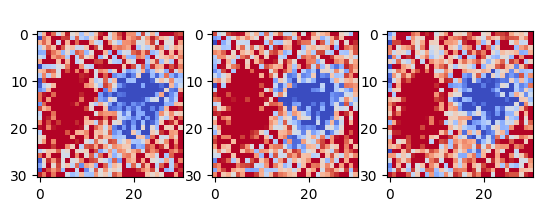

In [38]:
quick_animate([weights[:, 0, 0], weights[:, 0, 1], weights[:, 0, 2]], 294)

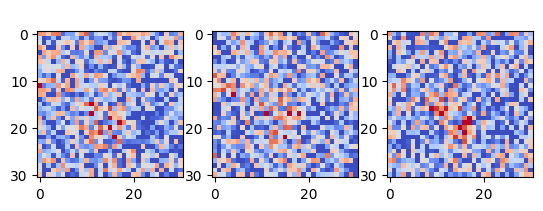

In [39]:
quick_animate([weights[:, 1, 0], weights[:, 1, 1], weights[:, 1, 2]], 294)

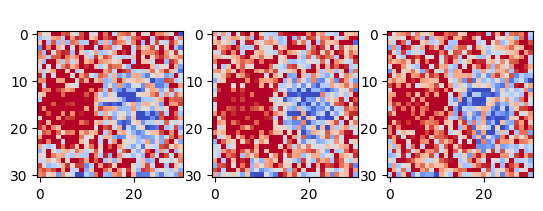

In [40]:
quick_animate([weights[:, 2, 0], weights[:, 2, 1], weights[:, 2, 2]], 294)

In [57]:
u = [torch.stack(item).cpu() for item in temp]
u = torch.stack(u[0:1000])

In [47]:
print(y[0].shape)
ppp = torch.stack([model.c1(frame) for frame in y[0]])
ppp.shape
#quick_animate([ppp[:,0,0], ppp[:,1,0], ppp[:,1,1]], (15,15), 50)

torch.Size([50, 8, 4, 31, 31])


torch.Size([50, 8, 4, 15, 15])

In [25]:
model.output_records

tensor([[[ 293.8469, -312.9575, -293.1801,  217.0788, -329.4860, -292.9966,
          -281.9355, -333.8281, -280.0349, -256.3044, -259.3539],
         [ 347.4601, -328.1610, -314.9720,  181.4602, -358.6683, -338.0463,
          -307.8124, -363.0659, -305.9372, -274.9074, -287.1631],
         [ 267.0184, -273.8769, -259.6437,  181.5813, -291.9732, -263.9323,
          -249.7974, -295.8392, -248.5465, -226.6405, -231.3789],
         [ 307.1163, -282.8170, -272.7402,  147.1560, -311.9325, -297.6088,
          -268.4014, -315.2229, -265.6438, -237.8895, -250.5253],
         [ 270.0234, -281.7689, -265.6865,  189.7187, -298.6089, -268.7126,
          -256.0283, -302.5666, -253.8724, -231.9786, -235.8302],
         [ 331.1671, -296.2974, -286.8500,  141.7849, -328.5166, -318.6494,
          -282.6971, -331.9519, -281.8790, -249.3513, -265.2941],
         [ 296.2484, -270.4505, -261.0702,  136.3548, -298.4885, -286.0188,
          -256.6797, -302.5505, -255.2578, -227.4202, -240.3272],
      

In [1]:
model.stdp_inshallah.weight

NameError: name 'model' is not defined

torch.Size([15, 50, 8, 4, 6, 6])


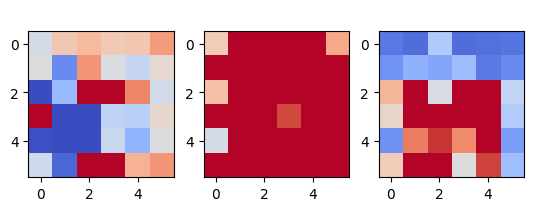

In [15]:
z = [torch.stack(item).cpu() for item in s2_rec]
z = torch.stack(z[0:len(z)-1])
print(z.shape)
quick_animate([z[0,:,0,0], z[len(z)//2,:,0,0],
              z[-1,:,0,0]], (6,6), len(z[0]))

torch.Size([15, 50, 8, 1, 64, 64])


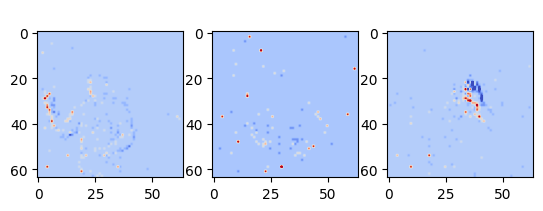

In [18]:
a = [torch.stack(item).cpu() for item in input_rec]
a = torch.stack(a[0:len(a)-1])
print(a.shape)
quick_animate([a[0,:,0,0], a[len(a)//2,:,0,0],
              a[-1,:,0,0]], (64,64), len(a[0]))

In [ ]:
x = [torch.stack(item).cpu() for item in s1_rec]
x = torch.stack(x[0:len(x)-1])
print(x.shape)
quick_animate([x[0,:,0,0], x[len(x)//2,:,0,0],
              x[-1,:,0,0]], (62,62), len(x[0]))

torch.Size([15, 50, 8, 4, 62, 62])


torch.Size([15, 50, 8, 4, 31, 31])


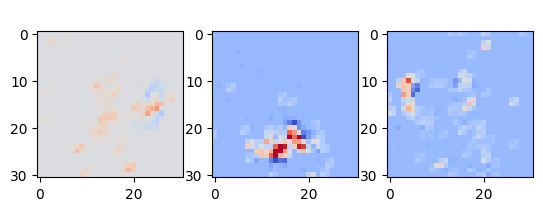

In [29]:
y = [torch.stack(item).cpu() for item in c1_rec]
y = torch.stack(y[0:len(y)-1])
print(y.shape)
quick_animate([y[-1,:,1,3], y[-1,:,3,3],
              y[-1,:,4,3]], (31,31), len(y[0]))

torch.Size([15, 50, 8, 4, 3, 3])


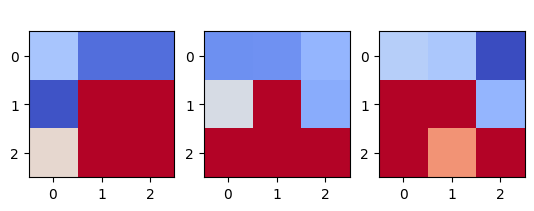

In [25]:
#w = [torch.stack(item).cpu() for item in c2_rec]
#w = torch.stack(w[0:len(w)-1])
print(w.shape)
quick_animate([w[-1,:,1,3], w[-1,:,3,3],
              w[-1,:,4,3]], (3,3), len(w[0]))

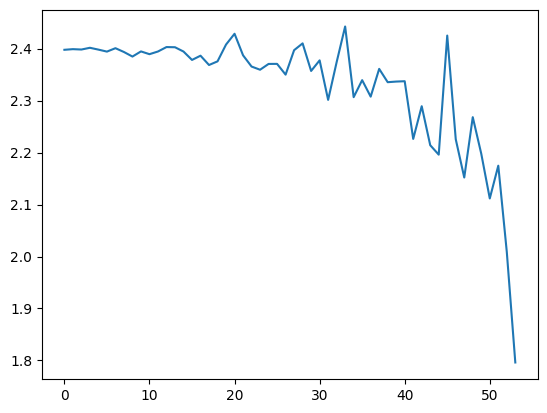

In [32]:
plt.plot([item.cpu().detach().numpy() for item in loss_hist])

## Visualizing Kernels

In [57]:
x = weights
x.shape

torch.Size([102, 4, 10, 5, 5])

ValueError: cannot reshape array of size 25 into shape (3,3)

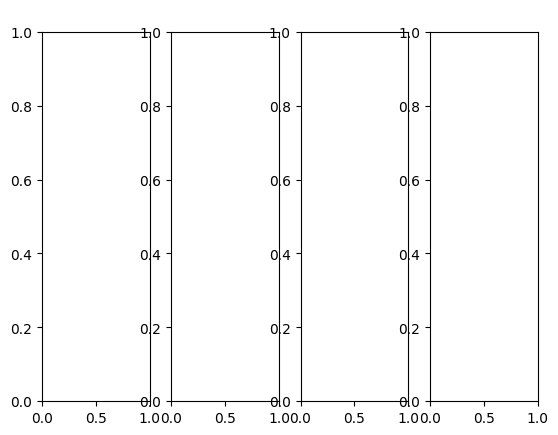

In [34]:
quick_animate([x[:,0,1], x[:,0,4], x[:,0,7], x[:,0,9]], (3,3), 200)

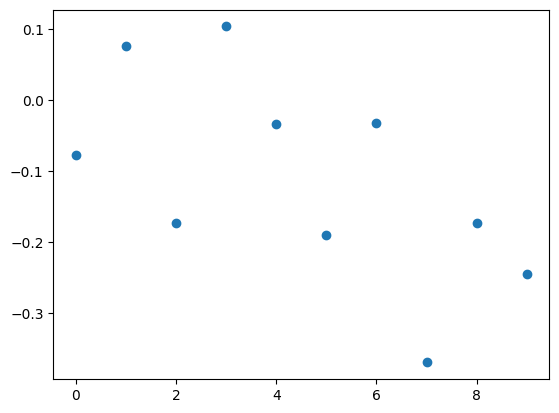

In [59]:
fig, ax = plt.subplots(1,1)
def animate(jjj):
    ax.clear()
    ax.scatter(range(10),x[jjj,0].sum((1,2)))
        
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(x))
HTML(ani.to_jshtml())